In [1]:
import os
from datetime import datetime
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from pandas_datareader.famafrench import get_available_datasets
import pandas_datareader.data as web
pd.set_option("display.max_rows",None,"display.max_columns",None)
from tqdm import tqdm

In [2]:
names=['gvkey','datadate','fyear','indfmt','consol','popsrc','datafmt','tic','curcd','ap','at','che','cogs','csho','dltt','dvp','invt','lct','ni','rect','revt','wcap','xint','xopr','xsga','costat','ggroup']
findata = pd.read_csv('file:///Users/marycarolinekreps/Downloads/data1.csv',names=names,low_memory=False,parse_dates=['datadate'],delim_whitespace=True)



In [3]:
#Import Data
findata = pd.read_csv('file:///Users/marycarolinekreps/Downloads/data1.csv')
gdp=pd.read_csv('file:///Users/marycarolinekreps/Downloads/GDP.csv')
findata['datadate'] = pd.to_datetime(findata['datadate'], utc=True,errors='coerce')
findata.dropna(axis=0,how='all',inplace=True)
print(len(findata))
display(findata.head())
print(len(gdp))
display(gdp.head())
#print(len(inflation))
#display(inflation.head())

315441


,gvkey,datadate,fyear,indfmt,consol,popsrc,datafmt,tic,curcd,ap,at,che,cogs,csho,dltt,dvp,invt,lct,ni,rect,revt,wcap,xint,xopr,xsga,costat,ggroup
0,1000,1961-12-31 00:00:00+00:00,1961,INDL,C,D,STD,AE.2,USD,NaN,NaN,NaN,NaN,0.152,0.100,0.0,NaN,NaN,NaN,NaN,0.900,NaN,NaN,NaN,NaN,I,NaN
1,1000,1962-12-31 00:00:00+00:00,1962,INDL,C,D,STD,AE.2,USD,NaN,NaN,NaN,NaN,0.181,0.000,0.0,NaN,NaN,NaN,NaN,1.600,NaN,0.010,NaN,NaN,I,NaN
2,1000,1963-12-31 00:00:00+00:00,1963,INDL,C,D,STD,AE.2,USD,0.096,NaN,NaN,1.065,0.186,0.015,0.0,0.133,0.322,0.003,0.250,1.457,0.086,0.020,1.411,0.346,I,NaN
3,1000,1964-12-31 00:00:00+00:00,1964,INDL,C,D,STD,AE.2,USD,0.146,1.416,0.269,1.474,0.196,0.522,0.0,0.204,0.267,0.052,0.230,2.032,0.451,0.033,1.905,0.431,I,NaN
4,1000,1965-12-31 00:00:00+00:00,1965,INDL,C,D,STD,AE.2,USD,0.272,2.310,0.031,1.342,0.206,1.154,0.0,0.378,0.623,-0.197,0.291,1.688,0.102,0.062,1.848,0.506,I,NaN


300


,DATE,GDP
0,1947-01-01,243.164
1,1947-04-01,245.968
2,1947-07-01,249.585
3,1947-10-01,259.745
4,1948-01-01,265.742


In [4]:
findata.fillna(0,inplace=True)

In [5]:
X = findata.iloc[:, 19].values.reshape(-1,1)
y = findata.iloc[:, 18].values.reshape(-1,1) 


In [6]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 1/3, random_state = 0)

In [7]:
from sklearn.linear_model import LinearRegression
reg=LinearRegression().fit(X,y)

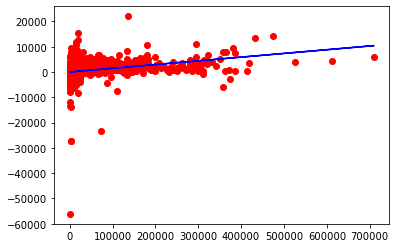

In [8]:
y_pred = reg.predict(X_test)
plt.scatter(X_train, y_train, color = 'red')
plt.plot(X_train, reg.predict(X_train), color = 'blue')

In [9]:
findata.iloc[[2000],19]

2000    22.999
Name: rect, dtype: float64

In [10]:
reg.predict(findata.iloc[[2000],19].values.reshape(-1,1))

array([[23.29066428]])

In [11]:
####TIME SERIES FORECASTING####

In [12]:
fdata = findata [['datadate','gvkey','fyear','ni','dvp', 'csho','ap','at','che','cogs','dltt','invt','lct','rect','revt','wcap','xint','xopr','xsga']]

In [13]:
fdata.describe()

,gvkey,fyear,ni,dvp,csho,ap,at,che,cogs,dltt,invt,lct,rect,revt,wcap,xint,xopr,xsga
count,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,3.154410e+05,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000,315441.000000
mean,19338.443747,1985.194055,29.443022,1.077798,21.491625,369.661186,1.999810e+03,132.216086,450.117621,299.814417,89.711175,160.148768,441.816555,712.233353,46.646542,48.094952,536.989237,86.894493
std,28842.577366,11.760605,297.195636,24.513705,204.505824,6135.422188,1.739771e+04,1974.508152,2931.029632,3324.607469,1504.907012,1512.433081,6627.397588,4031.121258,434.449249,553.931484,3337.984710,614.895245
min,1000.000000,1950.000000,-56121.900000,-116.643000,0.000000,-2.457000,0.000000e+00,-40.000000,-366.645000,0.000000,-3.116000,-0.002000,-0.009000,-203.746000,-37532.285000,-9.170000,-317.197000,-283.000000
25%,5390.000000,1977.000000,0.000000,0.000000,0.952000,0.001000,6.747000e+00,0.110000,1.119000,0.000000,0.000000,0.000000,0.104000,5.487000,0.000000,0.004000,2.224000,0.000000
50%,9752.000000,1987.000000,0.647000,0.000000,3.622000,1.532000,5.002000e+01,1.982000,18.270000,3.530000,1.500000,4.300000,4.028000,40.197000,1.633000,0.448000,25.666000,2.877000
75%,17166.000000,1995.000000,7.793000,0.000000,11.544000,14.291000,3.680740e+02,14.293000,121.991000,47.330000,17.016000,29.041000,32.550000,223.823000,20.009000,5.400000,155.110000,20.447000
max,277918.000000,2001.000000,26305.000000,12800.000000,91125.785000,503631.000000,1.051450e+06,273035.305000,189081.000000,419975.000000,239719.243000,208880.000000,709872.000000,206083.000000,31874.000000,41080.000000,194497.000000,31550.000000


In [14]:
fdata.head()

,datadate,gvkey,fyear,ni,dvp,csho,ap,at,che,cogs,dltt,invt,lct,rect,revt,wcap,xint,xopr,xsga
0,1961-12-31 00:00:00+00:00,1000,1961,0.000,0.0,0.152,0.000,0.000,0.000,0.000,0.100,0.000,0.000,0.000,0.900,0.000,0.000,0.000,0.000
1,1962-12-31 00:00:00+00:00,1000,1962,0.000,0.0,0.181,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.600,0.000,0.010,0.000,0.000
2,1963-12-31 00:00:00+00:00,1000,1963,0.003,0.0,0.186,0.096,0.000,0.000,1.065,0.015,0.133,0.322,0.250,1.457,0.086,0.020,1.411,0.346
3,1964-12-31 00:00:00+00:00,1000,1964,0.052,0.0,0.196,0.146,1.416,0.269,1.474,0.522,0.204,0.267,0.230,2.032,0.451,0.033,1.905,0.431
4,1965-12-31 00:00:00+00:00,1000,1965,-0.197,0.0,0.206,0.272,2.310,0.031,1.342,1.154,0.378,0.623,0.291,1.688,0.102,0.062,1.848,0.506


In [18]:
#fdata['datadate'] = pd.to_datetime(fdata['datadate'])

In [16]:

#fdata.set_index('datadate', inplace=True)

In [19]:
#
#df1 = fdata[fdata.index.year.isin([1991, 1992, 1993])]
#display(df1.head())

In [ ]:
#df1 = df1.astype(str)


In [ ]:
#df1.isnull().sum()

In [ ]:
#values = df1.values
#groups = [0, 1, 2, 3, 4, 5, 6, 7,8,9,10,11,12,13,14,15,16,17]
#i = 1
# plot each column
#for group in groups:
   # plt.subplot(len(groups), 1, i)
   # plt.plot(values[:, group])
    #plt.title(df1.columns[group], y=0.5, loc='right')
   # i += 1


#plt.show()

In [ ]:
#plt.figure(num=None, figsize=(30, 10), dpi=80, facecolor='w', edgecolor='k')
#plt.title('Earnings Forecast', fontsize=30)

#plt.plot(df1.ni)


In [44]:
#Time series forecasting with ARIMA model
data=fdata[['datadate','ni']]
pd.DatetimeIndex(data['datadate']).date
data['datadate'].apply(lambda x: x.strftime('%m-%d-%Y'))
data['datadate']= data['datadate'].astype('datetime64[ns]')

data.head()

/var/folders/n6/_zwm378d4qsdyyjp298n39_h0000gn/T/ipykernel_32244/14471561.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['datadate']= data['datadate'].astype('datetime64[ns]')


,datadate,ni
0,1961-12-31,0.000
1,1962-12-31,0.000
2,1963-12-31,0.003
3,1964-12-31,0.052
4,1965-12-31,-0.197


In [45]:
# Sort the Order Date 
data.groupby('datadate')['ni'].sum().reset_index()

#print the sorted values
print(data.head(1))

#check any missing values
data.isnull().sum()

    datadate   ni
0 1961-12-31  0.0


datadate    0
ni          0
dtype: int64

In [46]:
# grouping sales according to Order Date
data.groupby('datadate')['ni'].sum().reset_index()


# min and max values of Order Date
print(data['ni'].min())
print(data['datadate'].max())

-56121.9
2001-12-31 00:00:00


In [47]:
data.head()

,datadate,ni
0,1961-12-31,0.000
1,1962-12-31,0.000
2,1963-12-31,0.003
3,1964-12-31,0.052
4,1965-12-31,-0.197


In [48]:
#set 'Order Date' as index
#data['datadate'] = pd.to_datetime(data['datadate'])
data = data.set_index('datadate')
data = data[data.index.year.isin([1998,1999, 2000, 2001])]

data.index

DatetimeIndex(['1998-05-31', '1999-05-31', '2000-05-31', '2001-05-31',
               '1998-12-31', '1999-12-31', '2000-12-31', '2001-12-31',
               '1998-10-31', '1999-10-31',
               ...
               '1999-12-31', '2000-12-31', '2001-12-31', '2001-12-31',
               '2000-12-31', '2001-12-31', '1998-07-31', '1999-07-31',
               '2000-12-31', '2001-12-31'],
              dtype='datetime64[ns]', name='datadate', length=48923, freq=None)

In [50]:
# average the daily sales value for each month 
# use start of each month as the timestamp
y = data['ni'].resample('MS').mean()
y['1998':]

datadate
1998-01-01    44.265797
1998-02-01    18.240945
1998-03-01    34.224696
1998-04-01    20.959030
1998-05-01    20.915205
1998-06-01    22.519125
1998-07-01    17.585349
1998-08-01    16.826672
1998-09-01    22.427721
1998-10-01    19.812985
1998-11-01    62.931415
1998-12-01    66.019382
1999-01-01    58.930179
1999-02-01    12.266711
1999-03-01    39.065263
1999-04-01    14.863147
1999-05-01    19.144567
1999-06-01    30.412976
1999-07-01    27.660561
1999-08-01    24.444944
1999-09-01    31.682855
1999-10-01    17.864905
1999-11-01    75.683487
1999-12-01    74.326571
2000-01-01    75.948673
2000-02-01    14.161326
2000-03-01    59.659618
2000-04-01    22.579747
2000-05-01    72.515064
2000-06-01    30.520588
2000-07-01    21.182319
2000-08-01    30.181228
2000-09-01    36.753494
2000-10-01    37.642590
2000-11-01    96.556782
2000-12-01    79.746901
2001-01-01    73.564772
2001-02-01    -1.595952
2001-03-01    19.734960
2001-04-01    14.366597
2001-05-01    43.700362
2001-06

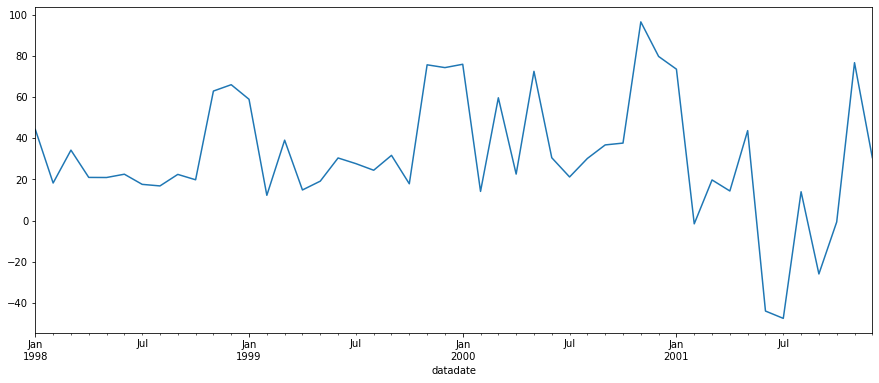

In [51]:
y.plot(figsize = (15, 6))
plt.show()


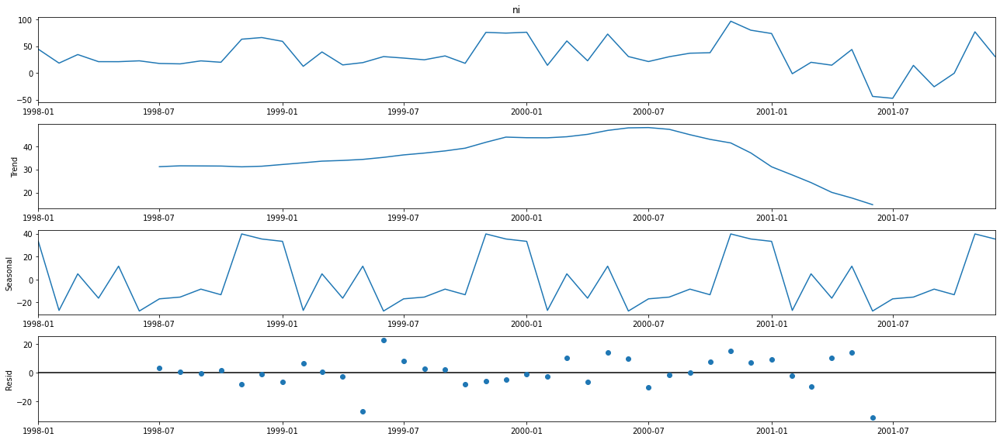

In [52]:
from pylab import rcParams
import statsmodels.api as sm
rcParams['figure.figsize'] = 18, 8

decomposition = sm.tsa.seasonal_decompose(y, model = 'additive')
fig = decomposition.plot()
plt.show()

In [53]:
#ARIMA
import itertools

In [54]:
# set the typical ranges for p, d, q
p = d = q = range(0, 2)

#take all possible combination for p, d and q
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [55]:
# Using Grid Search find the optimal set of parameters that yields the best performance
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y, order = param, seasonal_order = param_seasonal, enforce_stationary = False,enforce_invertibility=False) 
            result = mod.fit() 
            arima.fit(disp=0)
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, result.aic))
        except:
            continue

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.19318D+00    |proj g|=  5.24025D-09

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   5.240D-09   5.193D+00
  F =   5.1931839954589378     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.6

 This problem is unconstrained.
 This problem is unconstrained.

 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
 This problem is


           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      4     68      2     1     0   1.235D+05   2.013D+01
  F =   20.131681085002302     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.56292D+00    |proj g|=  1.05540D-02

At iterate    5    f=  3.54580D+00    |proj g|=  3.66596D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

 This problem is unconstrained.


  ys=-2.130E+02  -gs= 8.816E-01 BFGS update SKIPPED

At iterate    5    f=  2.28302D+01    |proj g|=  8.34369D+03
  ys=-1.105E+03  -gs= 9.981E-01 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6     67      2     2     0   8.344D+03   2.283D+01
  F =   22.830240961045561     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.59646D+00    |proj g|=  1.16635D-01

At iterate    5    f=  3.54717D+00    |proj g|=  3.95766D-02

At iterate   10    f=  3.53358D+00    |proj g|=  6.58016D-06

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.


  ys=-8.541E+01  -gs= 9.810E-01 BFGS update SKIPPED

At iterate    5    f=  2.72710D+01    |proj g|=  3.67398D+02
  ys=-1.526E+02  -gs= 9.853E-01 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.

 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8    111      3     2     0   2.712D+05   1.889D+01
  F =   18.890340902503056     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.46281D+00    |proj g|=  1.13706D-01

At iterate    5    f=  3.45206D+00    |proj g|=  3.82017D-02

At iterate   10    f=  3.43299D+00    |proj g|=  2.77085D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.94340D+00    |proj g|=  9.68456D-02

At iterate    5    f=  4.87116D+00    |proj g|=  2.88170D-02

At iterate   10    f=  4.70118D+00    |proj g|=  7.32688D-02

At iterate   15    f=  4.62317D+00    |proj g|=  1.53528D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     19     27      1     0     0   6.297D-08   4.623D+00
  F =   4.6230978110405161     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING 


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     13    101      2     2     0   4.409D+03   1.943D+01
  F =   19.428315624819792     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.52525D+00    |proj g|=  1.39605D-01

At iterate    5    f=  3.45226D+00    |proj g|=  8.03766D-03

At iterate   10    f=  3.43114D+00    |proj g|=  5.64574D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  3.42357D+00    |proj g|=  1.38451D-03

At iterate   20    f=  3.42354D+00    |proj g|=  5.20295D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     20     24      1     0     0   5.203D-06   3.424D+00
  F =   3.4235356975741404     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.84558D+00    |proj g|=  6.17203D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5     84      3     2     0   2.147D+05   1.943D+01
  F =   19.431261560558728     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.34358D+00    |proj g|=  1.37450D-02

At iterate    5    f=  3.32332D+00    |proj g|=  6.79723D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


At iterate    5    f=  4.53264D+00    |proj g|=  2.70751D-03

At iterate   10    f=  4.53150D+00    |proj g|=  1.99281D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2     12     13      1     0     0   6.643D-06   4.531D+00
  F =   4.5314908570749655     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.60655D+01    |proj g|=  3.16931D-02



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5     75      2     0     0   6.781D+04   2.036D+01
  F =   20.358018852555013     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33927D+00    |proj g|=  6.69315D-02

At iterate    5    f=  3.31983D+00    |proj g|=  6.09298D-02

At iterate   10    f=  3.31391D+00    |proj g|=  8.48210D-09

           * * *

Tit   = total number of iterations
Tnf   = total nu

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  3.30946D+00    |proj g|=  7.04250D-03

At iterate   20    f=  3.30928D+00    |proj g|=  6.48441D-04

At iterate   25    f=  3.30928D+00    |proj g|=  1.68576D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     25     27      1     0     0   1.686D-07   3.309D+00
  F =   3.3092819734026762     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.74009D+00    |proj g|=  6.57447D-02

At iter

 This problem is unconstrained.


  ys=-4.379E+01  -gs= 9.440E-01 BFGS update SKIPPED

At iterate    5    f=  2.54402D+01    |proj g|=  4.09255D+03
  ys=-3.749E+01  -gs= 9.545E-01 BFGS update SKIPPED

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      6     87      2     3     0   4.093D+03   2.544D+01
  F =   25.440229959439918     

ABNORMAL_TERMINATION_IN_LNSRCH                              



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.21246D+00    |proj g|=  3.08542D-02

At iterate    5    f=  3.21002D+00    |proj g|=  3.28013D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      5     11      1     0     0   3.280D-06   3.210D+00
  F =   3.2100197963349060     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 v

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   10    f=  4.40404D+00    |proj g|=  3.89554D-02

At iterate   15    f=  4.40137D+00    |proj g|=  2.47107D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     16     24      1     0     0   8.871D-07   4.401D+00
  F =   4.4013709308417681     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.60949D+01    |proj g|=  3.07739D-02
  ys=-3.349E+01  -gs= 1.006E+00 BFGS update SKIPPED

At iterate    5  


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     94      2     3     0   9.872D+04   2.079D+01
  F =   20.793951689706624     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.21585D+00    |proj g|=  7.45132D-02

At iterate    5    f=  3.20691D+00    |proj g|=  9.95390D-03

At iterate   10    f=  3.20415D+00    |proj g|=  2.35876D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  3.20104D+00    |proj g|=  3.71868D-04

At iterate   20    f=  3.20102D+00    |proj g|=  5.19163D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     22     24      1     0     0   4.626D-06   3.201D+00
  F =   3.2010233085572253     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.87017D+00    |proj g|=  4.60608D-04

At iterate    5    f=  4.87017D+00    |proj g|=  7.53412D-05

       


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
 This problem is unconstrained.


At iterate   10    f=  3.35206D+00    |proj g|=  1.07692D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     10     12      1     0     0   1.077D-06   3.352D+00
  F =   3.3520606733246727     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.71673D+00    |proj g|=  8.86997D-02

At iterate    5    f=  4.56613D+00    |proj g|=  6.53392D-02

At iterate   10    f=  4.52670D+00    |proj g|=  8.81821D-04

        

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.51401D+01    |proj g|=  1.14210D-01

At iterate    5    f=  2.56801D+01    |proj g|=  5.54997D+02
  ys=-7.773E+01  -gs= 9.887E-01 BFGS update SKIPPED
  ys=-4.484E+02  -gs= 9.967E-01 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     82      2     2     0   2.502D+05   2.057D+01
  F =   20.568753758494349     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.49783D+00    |proj g|=  2.13896D-01

At iterate    5    f=  3.35328D+00    |proj g|=  1.30421D-03

At iterate   10    f=  3.35304D+00    |proj g|=  3.23624D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate    5    f=  3.35239D+00    |proj g|=  8.94191D-03

At iterate   10    f=  3.35015D+00    |proj g|=  5.03928D-03

At iterate   15    f=  3.35000D+00    |proj g|=  1.23018D-03

At iterate   20    f=  3.34994D+00    |proj g|=  3.33754D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     23     26      1     0     0   2.303D-05   3.350D+00
  F =   3.3499382943890903     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  4.82134D+00    |proj g|=  1.84715D-03

At iterate   10    f=  4.82051D+00    |proj g|=  1.14538D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     12     15      1     0     0   8.134D-07   4.821D+00
  F =   4.8205087703612159     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.65736D+01    |proj g|=  3.23947D-02

At iterate    5    f=  2.82154D+01    |proj g|=  1.77177D+02
  ys=-2.


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     86      2     1     0   3.232D+04   2.101D+01
  F =   21.012162154834343     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.98937D+00    |proj g|=  1.15460D+01

At iterate    5    f=  3.34851D+00    |proj g|=  1.62604D-01

At iterate   10    f=  3.29929D+00    |proj g|=  6.50847D-03

At iterate   15    f=  3.29781D+00    |proj g|=  2.43546D-03

       

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.98937D+00    |proj g|=  1.15460D+01

At iterate    5    f=  3.35100D+00    |proj g|=  1.92569D-01

At iterate   10    f=  3.29611D+00    |proj g|=  3.57739D-02

At iterate   15    f=  3.29448D+00    |proj g|=  1.63058D-02

At iterate   20    f=  3.29366D+00    |proj g|=  4.71845D-07

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     20     22      1     0     0   4.718D-07   3.294D+00
  F =   3.2936607142717569     

CONVERG

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  4.63395D+00    |proj g|=  1.78096D-02

At iterate   10    f=  4.49838D+00    |proj g|=  9.68669D-02

At iterate   15    f=  4.47705D+00    |proj g|=  2.95155D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     18     21      1     0     0   3.422D-07   4.477D+00
  F =   4.4770407460438015     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.51306D+01    |proj g|=  1.17431D-01

At iter


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     13    102      2     3     0   1.032D+05   1.888D+01
  F =   18.876284605873646     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31749D+00    |proj g|=  8.08009D+00

At iterate    5    f=  3.40665D+00    |proj g|=  1.96531D-01

At iterate   10    f=  3.30822D+00    |proj g|=  7.96569D-02

At iterate   15    f=  3.29598D+00    |proj g|=  5.97220D-03

At iter

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate   25    f=  3.29116D+00    |proj g|=  5.14998D-04

At iterate   30    f=  3.29112D+00    |proj g|=  3.19495D-04

At iterate   35    f=  3.29111D+00    |proj g|=  5.34324D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     35     41      1     0     0   5.343D-06   3.291D+00
  F =   3.2911141306383791     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.76222D+00    |proj g|=  3.26735D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.

 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5     77      2     0     0   6.674D+04   2.061D+01
  F =   20.613750804252479     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.25360D+00    |proj g|=  1.69353D-03

At iterate    5    f=  3.25359D+00    |proj g|=  8.57345D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.76222D+00    |proj g|=  4.94948D-01

At iterate    5    f=  4.54230D+00    |proj g|=  7.30901D-02

At iterate   10    f=  4.45343D+00    |proj g|=  3.83171D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     14     17      1     0     0   4.891D-06   4.453D+00
  F =   4.4533902433360248     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      5     77      2     0     0   8.279D+04   2.026D+01
  F =   20.255676568513636     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.24516D+00    |proj g|=  4.81113D-02

At iterate    5    f=  3.24203D+00    |proj g|=  5.36403D-03

At iterate   10    f=  3.24160D+00    |proj g|=  6.76395D-05

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.



At iterate   10    f=  3.23828D+00    |proj g|=  2.18169D-03

At iterate   15    f=  3.23759D+00    |proj g|=  2.14141D-03

At iterate   20    f=  3.23754D+00    |proj g|=  6.33777D-05

At iterate   25    f=  3.23753D+00    |proj g|=  9.71971D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     28     32      1     0     0   7.029D-06   3.238D+00
  F =   3.2375340829796815     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.63435D+01    |proj g|=  3.07782D-02
  ys=-5.523E+01  -gs= 9.649E-01 BFGS update SKIPPED

At iterate    5    f=  2.24764D+01    |proj g|=  4.23836D+04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     72      1     1     0   3.694D+04   2.099D+01
  F =   20.994142115026353     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N = 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.21518D+00    |proj g|=  7.66053D-02

At iterate    5    f=  3.20554D+00    |proj g|=  4.78697D-03

At iterate   10    f=  3.20273D+00    |proj g|=  2.73106D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     14     17      1     0     0   2.407D-05   3.202D+00
  F =   3.2022985318671000     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  4.55902D+00    |proj g|=  2.59055D-02

At iterate   10    f=  4.51034D+00    |proj g|=  6.10227D-01

At iterate   15    f=  4.48324D+00    |proj g|=  2.19536D-01

At iterate   20    f=  4.43003D+00    |proj g|=  7.06297D-02

At iterate   25    f=  4.42105D+00    |proj g|=  3.20926D-01

At iterate   30    f=  4.40041D+00    |proj g|=  6.07561D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     33     51      1     0     0   2.806D-06   4.400D+00
  F =   4.4004082474534565     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machin

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


  ys=-2.310E+01  -gs= 9.426E-01 BFGS update SKIPPED

At iterate    5    f=  2.44539D+01    |proj g|=  5.70731D+03
  ys=-3.294E+01  -gs= 9.517E-01 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      6     85      2     2     0   5.707D+03   2.445D+01
  F =   24.453854957212837     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.21941D+00    |proj g|=  1.10634D-01

At iterate    5    f=  3.20641D+00    |proj g|=  4.26344D-03

At iterate   10    f=  3.20387D+00    |proj g|=  1.36453D-02

At iterate   15    f=  3.20338D+00    |proj g|=  5.60880D-06

       

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate    5    f=  3.20585D+00    |proj g|=  5.06058D-03

At iterate   10    f=  3.20331D+00    |proj g|=  4.44559D-02

At iterate   15    f=  3.20042D+00    |proj g|=  1.83707D-03

At iterate   20    f=  3.20023D+00    |proj g|=  1.29472D-03

At iterate   25    f=  3.20017D+00    |proj g|=  4.23283D-04

At iterate   30    f=  3.20016D+00    |proj g|=  1.80797D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     32     36      1     0     0   3.940D-06   3.200D+00
  F =   3.2001640129146516     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


In [56]:
#Fitting the ARIMA model using above optimal combination of p, d, q (optimal means combination at which we got lowest AIC score)

model = sm.tsa.statespace.SARIMAX(y, order = (1, 1, 1),
                                  seasonal_order = (1, 1, 0, 12)
                                 )
result = model.fit()
print(result.summary().tables[1])

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.21941D+00    |proj g|=  7.63624D-02

At iterate    5    f=  3.20607D+00    |proj g|=  4.10365D-03

At iterate   10    f=  3.20338D+00    |proj g|=  1.47553D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     12     14      1     0     0   9.781D-06   3.203D+00
  F =   3.2033799874192881     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
                 coef    std err          z      P>|z|      [0.025    

 This problem is unconstrained.


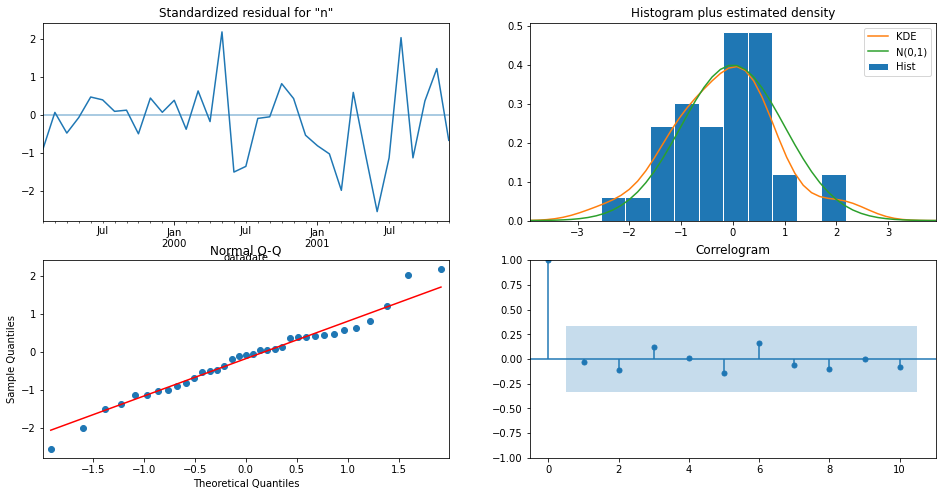

In [57]:
#run model diagnostic to investigate any unusual behavior
result.plot_diagnostics(figsize = (16, 8))
plt.show()

In [ ]:
#normally distributed

In [58]:
prediction = result.get_prediction(start = pd.to_datetime('2000-01-01'), dynamic = False)
prediction_ni = prediction.conf_int()
prediction_ni

,lower ni,upper ni
datadate,,
2000-01-01,30.144072,106.758646
2000-02-01,-16.545924,59.635488
2000-03-01,9.430869,85.439068
2000-04-01,-11.962036,63.997890
2000-05-01,-7.801756,68.144653
2000-06-01,21.755963,97.698581
2000-07-01,9.518165,85.459719
2000-08-01,-5.974779,69.966477
2000-09-01,-0.221994,75.719178


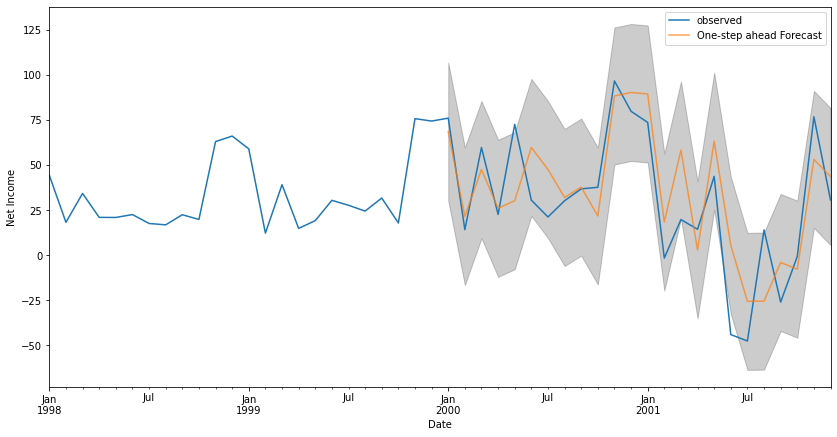

In [62]:
#Visualize the forecasting
ax = y['1998':].plot(label = 'observed')
prediction.predicted_mean.plot(ax = ax, label = 'One-step ahead Forecast', alpha = 0.7, figsize = (14, 7))
ax.fill_between(prediction_ni.index, prediction_ni.iloc[:, 0], prediction_ni.iloc[:, 1], color = 'k', alpha = 0.2)
ax.set_xlabel("Date")
ax.set_ylabel('Net Income')
plt.legend()
plt.show()

In [242]:
# Evaluation metrics are Squared Mean Error(SME) and Root Mean Squared Error(RMSE)
y_hat = prediction.predicted_mean
y_truth = y['2000-01-01':]

mse = ((y_hat - y_truth) ** 2).mean()
rmse = np.sqrt(mse)
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(rmse, 2)))

The Mean Squared Error of our forecasts is 517.67
The Root Mean Squared Error of our forecasts is 22.75


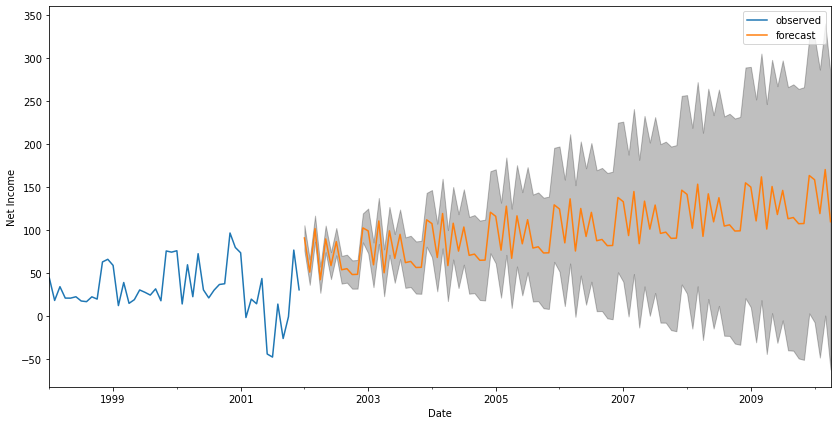

In [78]:
# forcasting for out of sample data
pred_uc = result.get_forecast(steps = 100)
pred_ni = pred_uc.conf_int()

ax = y.plot(label = 'observed', figsize = (14, 7))
pred_uc.predicted_mean.plot(ax = ax, label = 'forecast')
ax.fill_between(pred_ni.index, pred_ni.iloc[:, 0], pred_ni.iloc[:, 1], color = 'k', alpha = 0.25)
ax.set_xlabel('Date')
ax.set_ylabel('Net Income')

plt.legend()
plt.show()

In [ ]:
#the model shows seasonality for the years predicted, the forecast getting weaker as time goes on

In [65]:
#Time series forecasting with ARIMA model
cdata=fdata[['datadate','csho']]
pd.DatetimeIndex(cdata['datadate']).date
cdata['datadate'].apply(lambda x: x.strftime('%m-%d-%Y'))
cdata['datadate']= cdata['datadate'].astype('datetime64[ns]')

cdata.head()


/var/folders/n6/_zwm378d4qsdyyjp298n39_h0000gn/T/ipykernel_32244/2541076562.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cdata['datadate']= cdata['datadate'].astype('datetime64[ns]')


,datadate,csho
0,1961-12-31,0.152
1,1962-12-31,0.181
2,1963-12-31,0.186
3,1964-12-31,0.196
4,1965-12-31,0.206


In [ ]:

# Sort the Order Date 
cdata.groupby('datadate')['csho'].sum().reset_index()

#print the sorted values
print(cdata.head(1))

#check any missing values
cdata.isnull().sum()

In [66]:
# grouping sales according to Order Date
cdata.groupby('datadate')['csho'].sum().reset_index()


# min and max values of Order Date
print(cdata['csho'].min())
print(cdata['datadate'].max())

cdata.head()

0.0
2001-12-31 00:00:00


,datadate,csho
0,1961-12-31,0.152
1,1962-12-31,0.181
2,1963-12-31,0.186
3,1964-12-31,0.196
4,1965-12-31,0.206


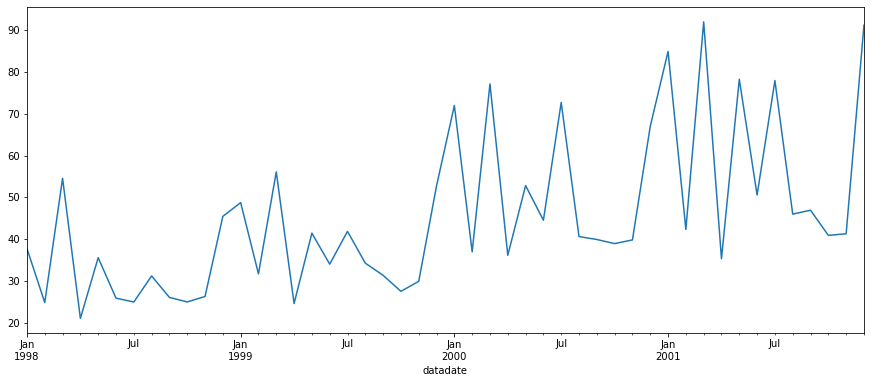

In [67]:
#set 'Order Date' as index
#data['datadate'] = pd.to_datetime(data['datadate'])
cdata = cdata.set_index('datadate')
cdata = cdata[cdata.index.year.isin([1998,1999, 2000, 2001])]

cdata.index

# average the daily sales value for each month 
# use start of each month as the timestamp
z = cdata['csho'].resample('MS').mean()
z['1998':]

z.plot(figsize = (15, 6))
plt.show()

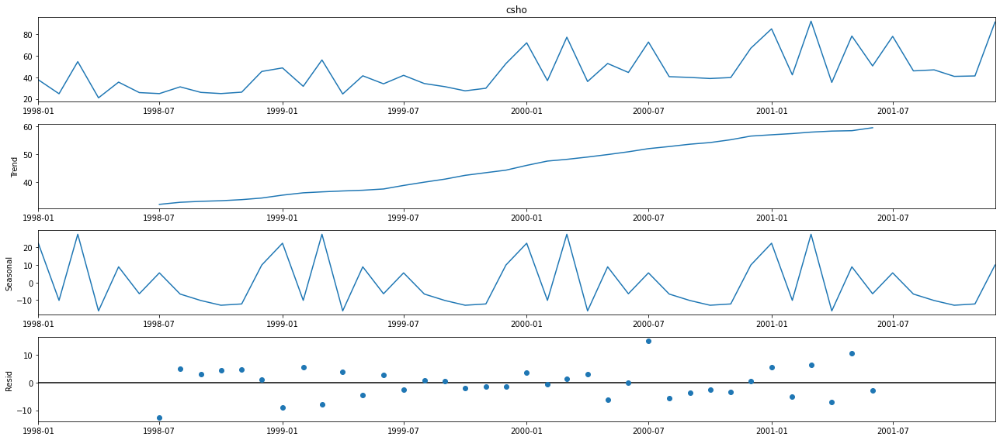

In [68]:
from pylab import rcParams
import statsmodels.api as sm
rcParams['figure.figsize'] = 18, 8

cdecomposition = sm.tsa.seasonal_decompose(z, model = 'additive')
fig = cdecomposition.plot()
plt.show()

In [69]:

#ARIMA
import itertools

# set the typical ranges for p, d, q
p = d = q = range(0, 2)

#take all possible combination for p, d and q
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

# Using Grid Search find the optimal set of parameters that yields the best performance
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(z, order = param, seasonal_order = param_seasonal, enforce_stationary = False,enforce_invertibility=False) 
            result = mod.fit() 
            arima.fit(disp=0)
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, result.aic))
        except:
            continue

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31183D+00    |proj g|=  4.26326D-09

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   4.263D-09   5.312D+00
  F =   5.3118307560761187     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL          

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.

 Bad direction in the line search

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.81737D+01    |proj g|=  3.57682D+01

At iterate    5    f=  4.92951D+00    |proj g|=  5.31855D-01

At iterate   10    f=  4.27643D+00    |proj g|=  9.84116D-03

At iterate   15    f=  4.27286D+00    |proj g|=  2.42762D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2     16     17      1     0     0   7.905D-08   4.273D+00
  F =   4.2728586186691571     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING 

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      4     69      3     1     0   1.472D+05   1.861D+01
  F =   18.609642337698531     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.81489D+00    |proj g|=  9.48553D-02

At iterate    5    f=  2.77127D+00    |proj g|=  9.63299D-03

At iterate   10    f=  2.76781D+00    |proj g|=  4.82769D-07

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  2.18403D+01    |proj g|=  1.31400D+05
  ys=-2.003E-01  -gs= 6.863E-01 BFGS update SKIPPED

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7     95      4     4     0   1.698D+05   2.098D+01
  F =   20.975554432853318     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.92258D+00    |proj g|=  2.83383D-01



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate    5    f=  2.87818D+00    |proj g|=  7.96550D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      9     13      1     0     0   1.679D-06   2.875D+00
  F =   2.8750415195615520     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.92258D+00    |proj g|=  3.44247D-01

At iterate    5    f=  2.81159D+00    |proj g|=  7.05470D-02

At iterate   10    f=  2.74734D+00    |proj g|=  3.42181D-03

At iter

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.34704D+00    |proj g|=  9.17374D-01

At iterate    5    f=  4.98478D+00    |proj g|=  1.64037D-02

At iterate   10    f=  4.83801D+00    |proj g|=  4.03539D-01

At iterate   15    f=  4.21411D+00    |proj g|=  1.77931D-01

At iterate   20    f=  4.16451D+00    |proj g|=  4.33865D-02

At iterate   25    f=  4.15351D+00    |proj g|=  5.41552D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     26     38      1     0     0   

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  1.96441D+01    |proj g|=  9.92958D+03

At iterate   10    f=  1.95957D+01    |proj g|=  7.85901D-01

At iterate   15    f=  1.95956D+01    |proj g|=  1.83954D+01

At iterate   20    f=  1.95947D+01    |proj g|=  2.12955D+02

At iterate   25    f=  1.95845D+01    |proj g|=  2.20841D+03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     28    119      4     3     0   3.973D+03   1.958D+01
  F =   19.575128769554649     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.89312D+00    |proj g|=  1.06302D-01

At iterate    5    f=  2.78123D+00    |proj g|=  1.06124D-01

At iterate   10    f=  2.74059D+00    |proj g|=  4.01315D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.81174D+00    |proj g|=  2.85046D-02

At iterate    5    f=  2.79147D+00    |proj g|=  3.31291D-08

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      5      6      1     0     0   3.313D-08   2.791D+00
  F =   2.7914731263556454     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 v

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


  ys=-9.665E+01  -gs= 9.693E-01 BFGS update SKIPPED

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      4     54      4     3     0   4.684D+04   1.862D+01
  F =   18.617466222888574     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.78141D+00    |proj g|=  6.86593D-02


/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  2.76398D+00    |proj g|=  6.88289D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    2      8     11      1     0     0   5.342D-07   2.764D+00
  F =   2.7639216073816208     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.79163D+00    |proj g|=  1.72412D-01

At iterate    5    f=  2.76360D+00    |proj g|=  1.76976D-02

At iterate   10    f=  2.76300D+00    |proj g|=  1.22118D-03

At iter

 This problem is unconstrained.

 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



At iterate    5    f=  2.45368D+01    |proj g|=  2.88276D+04
  ys=-4.518E-04  -gs= 1.065E-02 BFGS update SKIPPED

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      8     87      2     1     0   7.180D+05   1.602D+01
  F =   16.016770251665417     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.55765D+00    |proj g|=  7.18504D-02

At iterate    5    f=  2.55005D+00    |proj g|=  6.39554D-02

At iterate   10  

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting 

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.55765D+00    |proj g|=  7.18504D-02

At iterate    5    f=  2.54154D+00    |proj g|=  4.31495D-02

At iterate   10    f=  2.53697D+00    |proj g|=  9.96168D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     11     13      1     0     0   4.520D-06   2.537D+00
  F =   2.5369705130839244     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.23978D+01    |proj g|=  4.95434D-02
  ys=-3.946E+01  -gs= 9.277E-01 BFGS update SKIPPED

At iterate    5    f=  2.28053D+01    |proj g|=  1.09646D+03
  ys=-1.021E+00  -gs= 6.467E-01 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8     84      2     2     0   2.500D+05   1.582D+01
  F =   15.824396385054824     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.57466D+00    |proj g|=  1.13583D-01

At iterate    5    f=  2.53973D+00    |proj g|=  3.01353D-02

At iterate   10    f=  2.53650D+00    |proj g|=  1.86409D-05

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.



At iterate   15    f=  2.53583D+00    |proj g|=  5.28327D-03

At iterate   20    f=  2.53543D+00    |proj g|=  2.33750D-03

At iterate   25    f=  2.53528D+00    |proj g|=  1.46700D-03

At iterate   30    f=  2.53519D+00    |proj g|=  3.82280D-04

At iterate   35    f=  2.53515D+00    |proj g|=  2.49750D-03

At iterate   40    f=  2.53513D+00    |proj g|=  3.38378D-03

At iterate   45    f=  2.53512D+00    |proj g|=  5.13604D-04

At iterate   50    f=  2.53511D+00    |proj g|=  1.69143D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     50     61      1     0     0   1.691D-03   2.535D+00
  F =   2.53511405978

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
 This problem is unconstrained.
 This problem is unconstrained.

 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observatio


           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      5     77      2     0     0   9.451D+04   2.159D+01
  F =   21.589068700102558     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.79874D+00    |proj g|=  2.28405D-03

At iterate    5    f=  2.79872D+00    |proj g|=  4.59011D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   10    f=  3.97776D+00    |proj g|=  2.97640D-02

At iterate   15    f=  3.97608D+00    |proj g|=  1.04459D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3     15     23      1     0     0   1.045D-06   3.976D+00
  F =   3.9760827186458392     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.50008D+01    |proj g|=  4.14801D-02
  ys=-1.399E+02  -gs= 9.936E-01 BFGS update SKIPPED

At iterate    5  


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      8    122      2     4     0   8.140D+05   1.244D+01
  F =   12.437137431995588     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.84512D+00    |proj g|=  1.24291D-01

At iterate    5    f=  2.73406D+00    |proj g|=  1.49885D-02

At iterate   10    f=  2.72446D+00    |proj g|=  9.83114D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.


  ys=-3.814E+01  -gs= 9.751E-01 BFGS update SKIPPED

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      7     87      2     2     0   1.248D+04   2.523D+01
  F =   25.231002465122454     

ABNORMAL_TERMINATION_IN_LNSRCH                              



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.85608D+01    |proj g|=  4.17529D+02

At iterate    5    f=  2.82522D+00    |proj g|=  2.57621D-01

At iterate   10    f=  2.64763D+00    |proj g|=  2.84664D-01

At iterate   15    f=  2.62538D+00    |proj g|=  4.08943D-02

At iterate   20    f=  2.62038D+00    |proj g|=  3.22157D-02

At iterate   25    f=  2.61976D+00    |proj g|=  1.75930D-03

At iterate   30    f=  2.61963D+00    |proj g|=  2.54925D-04

At iterate   35    f=  2.61958D+00    |proj g|=  2.01312D-02

At iterate   40    f=  2.61956D+00    |proj g|=  1.15190D-03

At iterate   45    f=  2.61955D+00    |proj g|=  1.43892D-03

At iterate   50    f=  2.61955D+00    |proj g|=  8.66953D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.85608D+01    |proj g|=  4.17529D+02

At iterate    5    f=  2.74318D+00    |proj g|=  1.00957D-01

At iterate   10    f=  2.71321D+00    |proj g|=  2.17859D-01

At iterate   15    f=  2.63021D+00    |proj g|=  2.24144D-02

At iterate   20    f=  2.61033D+00    |proj g|=  4.85380D-03

At iterate   25    f=  2.60919D+00    |proj g|=  1.05179D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     28     33      1     0     0   

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate   25    f=  3.73413D+00    |proj g|=  7.95011D-02

At iterate   30    f=  3.73122D+00    |proj g|=  9.18782D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     32     45      1     0     0   1.869D-06   3.731D+00
  F =   3.7312185220976524     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.48450D+01    |proj g|=  4.79622D-02


/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  2.69753D+01    |proj g|=  1.96837D+02
  ys=-3.786E+01  -gs= 9.788E-01 BFGS update SKIPPED
  ys=-1.054E+02  -gs= 9.907E-01 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      7     85      2     2     0   2.113D+04   2.240D+01
  F =   22.401805513657340     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.37395D+01    |proj g|=  2.22634D+02

At iterate    5    f=  2.73662D+00    |proj g|=  5.65088D-02

At iterate   10    f=  2.68079D+00    |proj g|=  1.58777D-01

At iterate   15    f=  2.62466D+00    |proj g|=  2.28464D-02

At iter

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate   15    f=  2.62008D+00    |proj g|=  5.66454D-02

At iterate   20    f=  2.60972D+00    |proj g|=  4.06944D-03

At iterate   25    f=  2.60920D+00    |proj g|=  8.28099D-03

At iterate   30    f=  2.60907D+00    |proj g|=  1.82529D-03

At iterate   35    f=  2.60895D+00    |proj g|=  4.42546D-03

At iterate   40    f=  2.60892D+00    |proj g|=  5.28811D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     44     50      1     0     0   4.534D-05   2.609D+00
  F =   2.6089157529535156     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machin

 This problem is unconstrained.
 This problem is unconstrained.


  ys=-9.248E+01  -gs= 9.689E-01 BFGS update SKIPPED

At iterate    5    f=  1.76001D+01    |proj g|=  4.01964D+05
  ys=-1.084E+01  -gs= 8.373E-01 BFGS update SKIPPED
  ys=-2.969E-02  -gs= 8.244E-02 BFGS update SKIPPED



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    3      7    110      2     4     0   5.467D+05   1.613D+01
  F =   16.132419126176220     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            2     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.62441D+00    |proj g|=  9.03859D-03

At iterate    5    f=  2.62410D+00    |proj g|=  1.49987D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


  ys=-8.857E+01  -gs= 9.684E-01 BFGS update SKIPPED

At iterate    5    f=  1.74261D+01    |proj g|=  6.71737D+03



 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      6     99      2     2     0   6.717D+03   1.743D+01
  F =   17.426131510392423     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.65631D+00    |proj g|=  1.48957D-01

At iterate    5    f=  2.62208D+00    |proj g|=  1.95501D-03

At iterate   10    f=  2.62197D+00    |proj g|=  2.63243D-06

           * * *

Tit   = total number of iterations
Tnf   = total nu

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


At iterate   10    f=  2.62198D+00    |proj g|=  2.06236D-04

At iterate   15    f=  2.62197D+00    |proj g|=  2.44987D-04



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     18     31      1     0     0   1.504D-05   2.622D+00
  F =   2.6219737216626657     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  4.15813D+00    |proj g|=  4.14529D-02

At iterate    5    f=  4.14749D+00    |proj g|=  6.30746D-03

At iterate   10    f=  4.14655D+00    |proj g|=  7.94443D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu


 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.



           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4      4     70      2     1     0   2.736D+05   1.881D+01
  F =   18.809473033332441     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            3     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.54515D+00    |proj g|=  9.72530D-02

At iterate    5    f=  2.53439D+00    |proj g|=  1.76525D-02

At iterate   10    f=  2.53094D+00    |proj g|=  1.50182D-06

           * * *

Tit   = total number of iterations
Tnf   = total nu

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.54515D+00    |proj g|=  9.72530D-02

At iterate    5    f=  2.52908D+00    |proj g|=  1.30356D-02

At iterate   10    f=  2.52449D+00    |proj g|=  3.29301D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     11     13      1     0     0   6.951D-07   2.524D+00
  F =   2.5244902512135705     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.



At iterate    5    f=  3.85504D+00    |proj g|=  1.76756D-01

At iterate   10    f=  3.61120D+00    |proj g|=  1.48055D-01

At iterate   15    f=  3.58438D+00    |proj g|=  1.95413D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     19     29      1     0     0   5.955D-07   3.584D+00
  F =   3.5842390055012565     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            5     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.21917D+01    |proj g|=  5.72921D-02


/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:997: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'
 This problem is unconstrained.


  ys=-1.843E+01  -gs= 9.649E-01 BFGS update SKIPPED




 Bad direction in the line search;
   refresh the lbfgs memory and restart the iteration.
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "

 Line search cannot locate an adequate point after MAXLS
  function and gradient evaluations.
  Previous x, f and g restored.
 Possible causes: 1 error in function or gradient evaluation;
                  2 rounding error dominate computation.
 This problem is unconstrained.


           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5      4     70      2     1     0   1.128D+05   1.674D+01
  F =   16.742217758305721     

ABNORMAL_TERMINATION_IN_LNSRCH                              
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.55390D+00    |proj g|=  9.95157D-02

At iterate    5    f=  2.52997D+00    |proj g|=  2.60614D-02

At iterate   10    f=  2.52426D+00    |proj g|=  3.07404D-04

           * * *

Tit   = total number of iterations
Tnf   = total num

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 This problem is unconstrained.



At iterate   10    f=  2.52430D+00    |proj g|=  5.71924D-04

At iterate   15    f=  2.52424D+00    |proj g|=  3.95615D-03

At iterate   20    f=  2.52420D+00    |proj g|=  3.09189D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    5     22     24      1     0     0   3.615D-06   2.524D+00
  F =   2.5242008841322874     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.55390D+00    |proj g|=  9.95157D-02

At iterate    5    f=  2.52491D+00    |proj g|=  1.43084D-02

At iterate   10    f=  2.52426D+00    |proj g|=  4.27947D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     10     13      1     0     0   4.279D-06   2.524D+00
  F =   2.5242576985953522     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
                 coef    std err          z      P>|z|      [0.025    

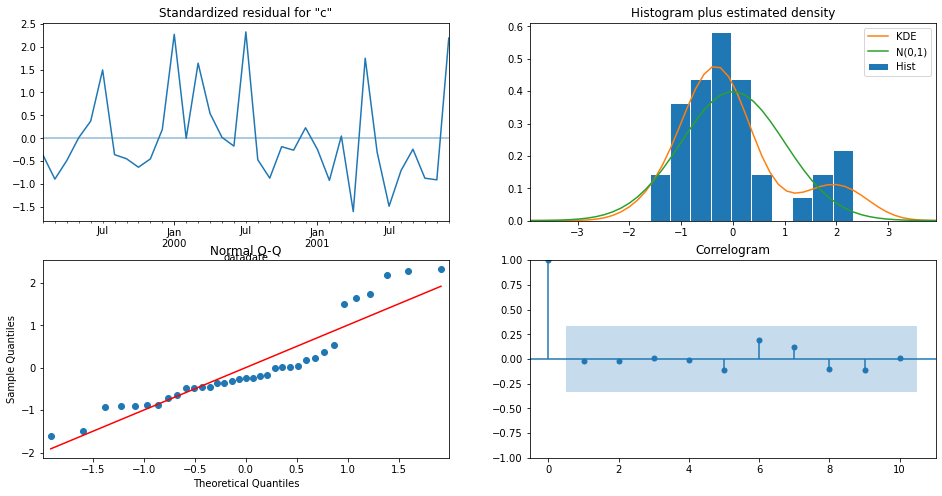

In [71]:

#Fitting the ARIMA model using above optimal combination of p, d, q (optimal means combination at which we got lowest AIC score)

zmodel = sm.tsa.statespace.SARIMAX(z, order = (1, 1, 1),
                                  seasonal_order = (1, 1, 0, 12)
                                 )
zresult = zmodel.fit()
print(zresult.summary().tables[1])

#run model diagnostic to investigate any unusual behavior
result.plot_diagnostics(figsize = (16, 8))
plt.show()

In [72]:
#normally distributed

predictioncsho = zresult.get_prediction(start = pd.to_datetime('2000-01-01'), dynamic = False)
prediction_csho = predictioncsho.conf_int()
prediction_csho


,lower csho,upper csho
datadate,,
2000-01-01,40.091988,69.640226
2000-02-01,22.189700,51.737433
2000-03-01,50.056865,79.580828
2000-04-01,17.295566,46.804894
2000-05-01,37.940400,67.440695
2000-06-01,31.082973,60.577685
2000-07-01,40.519436,70.010694
2000-08-01,29.414648,58.903767
2000-09-01,31.727875,61.215670


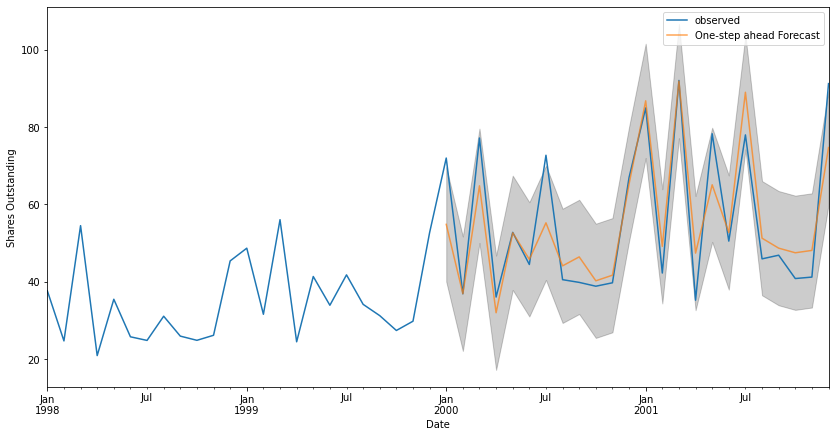

In [75]:
#Visualize the forecasting
zax = z['1998':].plot(label = 'observed')
predictioncsho.predicted_mean.plot(ax = zax, label = 'One-step ahead Forecast', alpha = 0.7, figsize = (14, 7))
zax.fill_between(prediction_csho.index, prediction_csho.iloc[:, 0], prediction_csho.iloc[:, 1], color = 'k', alpha = 0.2)
zax.set_xlabel("Date")
zax.set_ylabel('Shares Outstanding')
plt.legend()
plt.show()

In [76]:


# Evaluation metrics are Squared Mean Error(SME) and Root Mean Squared Error(RMSE)
z_hat = predictioncsho.predicted_mean
z_truth = z['2000-01-01':]

mse = ((z_hat - z_truth) ** 2).mean()
rmse = np.sqrt(mse)
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(rmse, 2)))

The Mean Squared Error of our forecasts is 74.54
The Root Mean Squared Error of our forecasts is 8.63


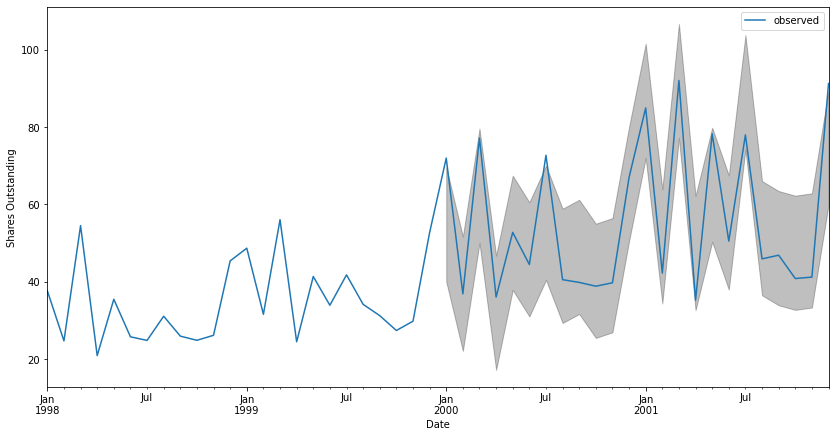

In [80]:
# forcasting for out of sample data
pred_uc = zresult.get_forecast(steps = 100)
pred_ni = pred_uc.conf_int()

ax = z.plot(label = 'observed', figsize = (14, 7))
pred_uc.predicted_mean.plot(ax = zax, label = 'forecast')
ax.fill_between(prediction_csho.index, prediction_csho.iloc[:, 0], prediction_csho.iloc[:, 1], color = 'k', alpha = 0.25)
ax.set_xlabel('Date')
ax.set_ylabel('Shares Outstanding')

plt.legend()
plt.show()

In [ ]:
##DIVIDENDS

In [81]:
ddata=fdata[['datadate','dvp']]
pd.DatetimeIndex(ddata['datadate']).date
ddata['datadate'].apply(lambda x: x.strftime('%m-%d-%Y'))
ddata['datadate']= ddata['datadate'].astype('datetime64[ns]')

ddata.head()

/var/folders/n6/_zwm378d4qsdyyjp298n39_h0000gn/T/ipykernel_32244/3173562416.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ddata['datadate']= ddata['datadate'].astype('datetime64[ns]')


,datadate,dvp
0,1961-12-31,0.0
1,1962-12-31,0.0
2,1963-12-31,0.0
3,1964-12-31,0.0
4,1965-12-31,0.0


In [82]:
# Sort the Order Date 
ddata.groupby('datadate')['dvp'].sum().reset_index()

#print the sorted values
print(ddata.head(1))

#check any missing values
ddata.isnull().sum()

    datadate  dvp
0 1961-12-31  0.0


datadate    0
dvp         0
dtype: int64

In [83]:

# grouping sales according to Order Date
ddata.groupby('datadate')['dvp'].sum().reset_index()


# min and max values of Order Date
print(ddata['dvp'].min())
print(ddata['datadate'].max())

ddata.head()

-116.643
2001-12-31 00:00:00


,datadate,dvp
0,1961-12-31,0.0
1,1962-12-31,0.0
2,1963-12-31,0.0
3,1964-12-31,0.0
4,1965-12-31,0.0


In [84]:
#set 'Order Date' as index
#data['datadate'] = pd.to_datetime(data['datadate'])
ddata = ddata.set_index('datadate')
ddata = ddata[ddata.index.year.isin([1998,1999, 2000, 2001])]

ddata.index

DatetimeIndex(['1998-05-31', '1999-05-31', '2000-05-31', '2001-05-31',
               '1998-12-31', '1999-12-31', '2000-12-31', '2001-12-31',
               '1998-10-31', '1999-10-31',
               ...
               '1999-12-31', '2000-12-31', '2001-12-31', '2001-12-31',
               '2000-12-31', '2001-12-31', '1998-07-31', '1999-07-31',
               '2000-12-31', '2001-12-31'],
              dtype='datetime64[ns]', name='datadate', length=48923, freq=None)

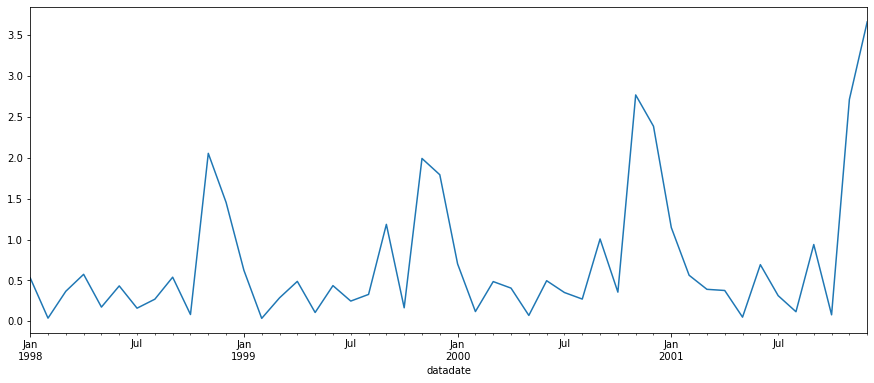

In [93]:
# average the daily sales value for each month 
# use start of each month as the timestamp
x = ddata['dvp'].resample('MS').mean()
x['1998':]

x.plot(figsize = (15, 6))
plt.show()

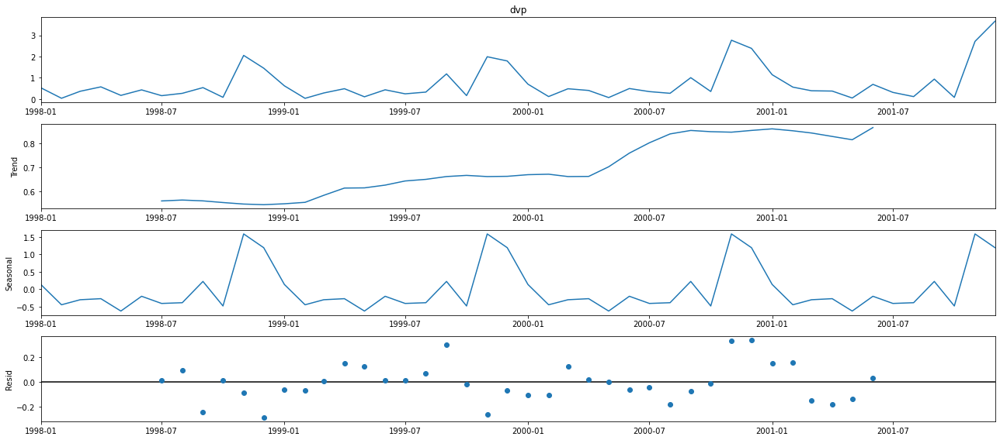

In [95]:

from pylab import rcParams
import statsmodels.api as sm
rcParams['figure.figsize'] = 18, 8

ddecomposition = sm.tsa.seasonal_decompose(x, model = 'additive')
fig = ddecomposition.plot()
plt.show()

In [96]:

#ARIMA
import itertools

# set the typical ranges for p, d, q
p = d = q = range(0, 2)

#take all possible combination for p, d and q
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [97]:

# Using Grid Search find the optimal set of parameters that yields the best performance
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(d, order = param, seasonal_order = param_seasonal, enforce_stationary = False,enforce_invertibility=False) 
            result = mod.fit() 
            arima.fit(disp=0)
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, result.aic))
        except:
            continue


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            4     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  2.29667D-01    |proj g|=  3.88964D-01

At iterate    5    f=  2.11905D-01    |proj g|=  1.30524D-02


 This problem is unconstrained.



At iterate   10    f=  2.11392D-01    |proj g|=  8.18035D-02

At iterate   15    f=  2.04307D-01    |proj g|=  2.76799D-02

At iterate   20    f=  2.02175D-01    |proj g|=  2.17681D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    4     22     30      1     0     0   3.259D-04   2.022D-01
  F =  0.20217534097824955     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5702      0.550     -1.036      0.300      -1.649       0.509


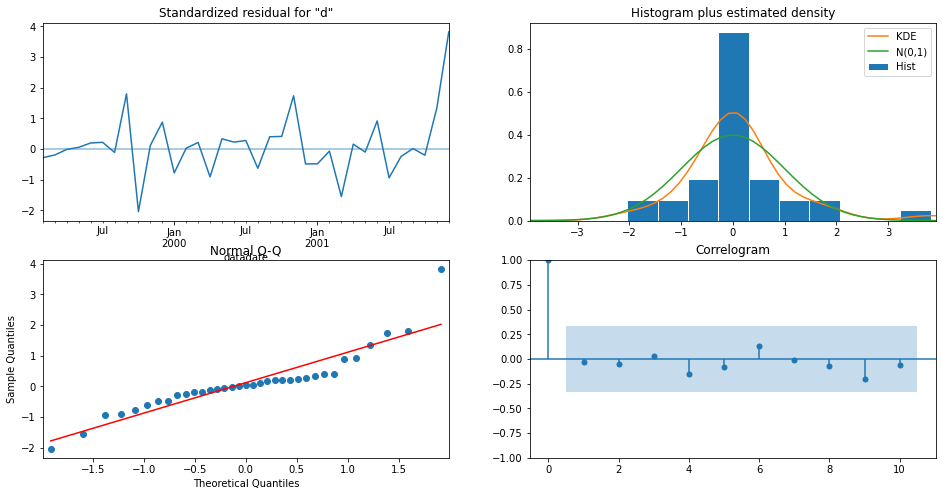

In [98]:
#Fitting the ARIMA model using above optimal combination of p, d, q (optimal means combination at which we got lowest AIC score)

dmodel = sm.tsa.statespace.SARIMAX(x, order = (1, 1, 1),
                                  seasonal_order = (1, 1, 0, 12)
                                 )
dresult = dmodel.fit()
print(dresult.summary().tables[1])

#run model diagnostic to investigate any unusual behavior
dresult.plot_diagnostics(figsize = (16, 8))
plt.show()

In [99]:
#normally distributed

predictiondvp = dresult.get_prediction(start = pd.to_datetime('2000-01-01'), dynamic = False)
prediction_dvp = predictiondvp.conf_int()
prediction_dvp


,lower dvp,upper dvp
datadate,,
2000-01-01,0.310058,1.608009
2000-02-01,-0.503188,0.724302
2000-03-01,-0.194799,1.031082
2000-04-01,0.076711,1.301688
2000-05-01,-0.644968,0.579497
2000-06-01,-0.186774,1.037403
2000-07-01,-0.347224,0.876789
2000-08-01,-0.144659,1.079261
2000-09-01,0.269425,1.493293


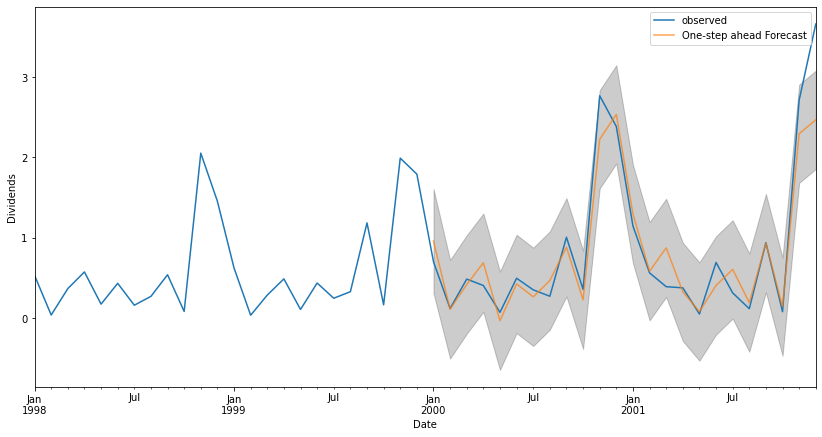

In [100]:




#Visualize the forecasting
dax = x['1998':].plot(label = 'observed')
predictiondvp.predicted_mean.plot(ax = dax, label = 'One-step ahead Forecast', alpha = 0.7, figsize = (14, 7))
dax.fill_between(prediction_dvp.index, prediction_dvp.iloc[:, 0], prediction_dvp.iloc[:, 1], color = 'k', alpha = 0.2)
dax.set_xlabel("Date")
dax.set_ylabel('Dividends')
plt.legend()
plt.show()

In [243]:
x_hat = predictiondvp.predicted_mean
x_truth = x['2000-01-01':]

mse = ((x_hat - x_truth) ** 2).mean()
rmse = np.sqrt(mse)
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(rmse, 2)))

The Mean Squared Error of our forecasts is 0.11
The Root Mean Squared Error of our forecasts is 0.33


In [ ]:
####put it together

In [102]:

prediction_ni['forecast ni']= (prediction_ni['lower ni']+prediction_ni['upper ni'])/2
prediction_ni

,lower ni,upper ni,forecast
datadate,,,
2000-01-01,30.144072,106.758646,68.451359
2000-02-01,-16.545924,59.635488,21.544782
2000-03-01,9.430869,85.439068,47.434968
2000-04-01,-11.962036,63.997890,26.017927
2000-05-01,-7.801756,68.144653,30.171449
2000-06-01,21.755963,97.698581,59.727272
2000-07-01,9.518165,85.459719,47.488942
2000-08-01,-5.974779,69.966477,31.995849
2000-09-01,-0.221994,75.719178,37.748592


In [104]:

prediction_csho['forecast csho']= (prediction_csho['lower csho']+prediction_csho['upper csho'])/2
prediction_csho

,lower csho,upper csho,forecast
datadate,,,
2000-01-01,40.091988,69.640226,54.866107
2000-02-01,22.189700,51.737433,36.963567
2000-03-01,50.056865,79.580828,64.818847
2000-04-01,17.295566,46.804894,32.050230
2000-05-01,37.940400,67.440695,52.690548
2000-06-01,31.082973,60.577685,45.830329
2000-07-01,40.519436,70.010694,55.265065
2000-08-01,29.414648,58.903767,44.159207
2000-09-01,31.727875,61.215670,46.471772


In [105]:
prediction_dvp['forecast dvp']= (prediction_dvp['lower dvp']+prediction_dvp['upper dvp'])/2
prediction_dvp

,lower dvp,upper dvp,forecast
datadate,,,
2000-01-01,0.310058,1.608009,0.959034
2000-02-01,-0.503188,0.724302,0.110557
2000-03-01,-0.194799,1.031082,0.418142
2000-04-01,0.076711,1.301688,0.689200
2000-05-01,-0.644968,0.579497,-0.032736
2000-06-01,-0.186774,1.037403,0.425315
2000-07-01,-0.347224,0.876789,0.264782
2000-08-01,-0.144659,1.079261,0.467301
2000-09-01,0.269425,1.493293,0.881359


In [127]:
forecast= ((prediction_ni['forecast']-prediction_dvp['forecast'])/prediction_csho['forecast'])
forecast


datadate
2000-01-01    1.230128
2000-02-01    0.579874
2000-03-01    0.725357
2000-04-01    0.790282
2000-05-01    0.573237
2000-06-01    1.293946
2000-07-01    0.854503
2000-08-01    0.713974
2000-09-01    0.793325
2000-10-01    0.533248
2000-11-01    2.060355
2000-12-01    1.342242
2001-01-01    1.014856
2001-02-01    0.360981
2001-03-01    0.624844
2001-04-01    0.054497
2001-05-01    0.970184
2001-06-01    0.094887
2001-07-01   -0.294442
2001-08-01   -0.499392
2001-09-01   -0.101570
2001-10-01   -0.166377
2001-11-01    1.055224
2001-12-01    0.550544
Freq: MS, Name: forecast, dtype: float64

In [148]:
df = pd.DataFrame(forecast)
df

,forecast
datadate,
2000-01-01,1.230128
2000-02-01,0.579874
2000-03-01,0.725357
2000-04-01,0.790282
2000-05-01,0.573237
2000-06-01,1.293946
2000-07-01,0.854503
2000-08-01,0.713974
2000-09-01,0.793325


In [236]:
forecast.to_csv('/Users/marycarolinekreps/Downloads/forecast.csv',index=True)


In [170]:
final= findata[['datadate','ni','dvp','csho']]
final['datadate'].apply(lambda x: x.strftime('%m-%d-%Y'))
final['datadate']=final['datadate'].astype('datetime64[ns]')
final.set_index("datadate",inplace=True)
final= final[final.index.year.isin([1998,1999, 2000, 2001])]
final['observed']= ((final['ni']-final['dvp'])/final['csho'])
#final.groupby(pd.Grouper(key='datadate', axis=0, freq='M')).mean()
#final['datadate'] = pd.to_datetime(final['datadate']).dt.date
#final['year'] = pd.DatetimeIndex(final['datadate']).year
#final['month'] = pd.DatetimeIndex(final['datadate']).month
#final['date']=final['year']+"-"+final['month']+"-01"k
#final[:5]
# get month from the corresponding
# birth_date column value
final

/var/folders/n6/_zwm378d4qsdyyjp298n39_h0000gn/T/ipykernel_32244/2668781947.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final['datadate']=final['datadate'].astype('datetime64[ns]')


,ni,dvp,csho,observed
datadate,,,,
1998-05-31,35.657,0.000,27.7040,1.287070e+00
1999-05-31,41.671,0.000,27.3810,1.521895e+00
2000-05-31,35.163,0.000,26.8650,1.308878e+00
2001-05-31,18.531,0.000,26.9370,6.879385e-01
1998-12-31,67.200,1.000,0.0150,4.413333e+03
1999-12-31,77.300,0.000,0.0150,5.153333e+03
2000-12-31,79.900,0.000,0.0150,5.326667e+03
2001-12-31,145.700,0.000,0.0010,1.457000e+05
1998-10-31,146.727,0.000,134.8970,1.087697e+00


In [218]:
final.to_csv('/Users/marycarolinekreps/Downloads/final.csv',index=True)


In [211]:
df2=final[['observed']]
#pd.DatetimeIndex(df2['datadate']).date
df2 = df2.astype(str)
df2 = df2.replace([np.inf, -np.inf], np.nan)
#df2['observed']= df2['observed'].fillna(0).astype(float)
#df2['observed']= df2['observed'].astype(int)
df2.dropna()
#df2['observed'] = df2['observed'].fillna(0).astype(int)
#pd.DatetimeIndex(df2['datadate']).date


,observed
datadate,
1998-05-31,1.2870704591394744
1999-05-31,1.521894744530879
2000-05-31,1.3088777219430485
2001-05-31,0.6879385232208486
1998-12-31,4413.333333333334
1999-12-31,5153.333333333333
2000-12-31,5326.666666666667
2001-12-31,145699.99999999997
1998-10-31,1.0876965388407454


In [ ]:
forecast=pd.read_csv('file:///Users/marycarolinekreps/Downloads/forecast.csv')


In [232]:
finale=pd.read_csv('file:///Users/marycarolinekreps/Downloads/finale.csv')
finale['datadate'] = pd.to_datetime(finale['datadate'], utc=True,errors='coerce')
finale.dropna(axis=0,how='all',inplace=True)
finale.set_index("datadate",inplace=True)


print(len(finale))
finale

48


,observed
datadate,
1998-01-01 00:00:00+00:00,95.878553
1998-02-01 00:00:00+00:00,6.217476
1998-03-01 00:00:00+00:00,-6.937238
1998-04-01 00:00:00+00:00,34.161908
1998-05-01 00:00:00+00:00,2211.616077
1998-06-01 00:00:00+00:00,48.579855
1998-07-01 00:00:00+00:00,-0.330284
1998-08-01 00:00:00+00:00,0.158178
1998-09-01 00:00:00+00:00,-43.619819


In [224]:
finalee = finale['observed'].resample('MS').mean()

In [239]:
#fdecomposition = sm.tsa.seasonal_decompose(finalee, model = 'additive')
df = df['forecast'].resample('MS').mean()
# calculate MAE
error = mae(finale['observed'],df['forecast'])
  
# display
print("Mean absolute error : " + str(error))

KeyError: 'forecast'

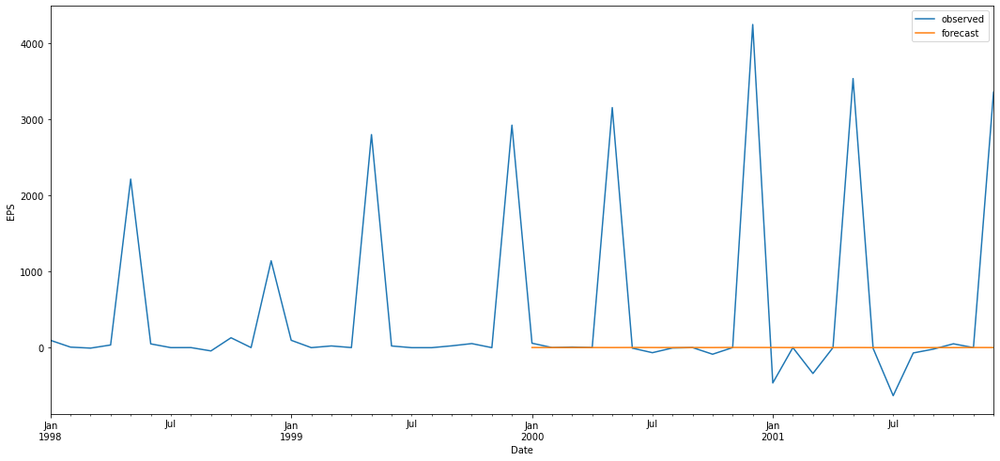

In [235]:
ax =finalee.plot()
df.plot(ax=ax)
ax.set_xlabel("Date")
ax.set_ylabel('EPS')
plt.legend()
plt.show()